In [ ]:
!pip install -U sentence-transformers
!pip install ipympl

In [ ]:
!wget https://www.google.com/basepages/producttype/taxonomy.en-US.txt

--2020-12-16 09:27:59--  https://www.google.com/basepages/producttype/taxonomy.en-US.txt
Resolving www.google.com (www.google.com)... 74.125.195.104, 74.125.195.106, 74.125.195.105, ...
Connecting to www.google.com (www.google.com)|74.125.195.104|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 441134 (431K) [text/plain]
Saving to: ‘taxonomy.en-US.txt’

taxonomy.en-US.txt  100%[===================>] 430.79K  --.-KB/s    in 0.003s  

2020-12-16 09:27:59 (129 MB/s) - ‘taxonomy.en-US.txt’ saved [441134/441134]



In [ ]:
categories = []
with open("taxonomy.en-US.txt", "r") as f:
  categories = f.readlines()
categories = categories[1:]

In [ ]:
main_category = [x[:-1] for x in categories if '>' not in x]

In [ ]:
main_category

['Animals & Pet Supplies',
 'Apparel & Accessories',
 'Arts & Entertainment',
 'Baby & Toddler',
 'Business & Industrial',
 'Cameras & Optics',
 'Electronics',
 'Food, Beverages & Tobacco',
 'Furniture',
 'Hardware',
 'Health & Beauty',
 'Home & Garden',
 'Luggage & Bags',
 'Mature',
 'Media',
 'Office Supplies',
 'Religious & Ceremonial',
 'Software',
 'Sporting Goods',
 'Toys & Games',
 'Vehicles & Parts']

In [ ]:
import requests
import os
import json
import torch
import numpy as np
import pandas as pd
from tqdm import tqdm
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

In [ ]:
# auth.authenticate_user()
# gauth = GoogleAuth()
# gauth.credentials = GoogleCredentials.get_application_default()
# drive = GoogleDrive(gauth)

In [ ]:
# download = drive.CreateFile({'id': '1721_AIpjrn-QveRqRUn6FxEmTbt2p48a'})
# download.GetContentFile('DOWNLOAD.tar')

In [ ]:
!wget https://s3-us-west-2.amazonaws.com/mumie/val.zip

--2020-11-12 13:00:30--  https://s3-us-west-2.amazonaws.com/mumie/val.zip
Resolving s3-us-west-2.amazonaws.com (s3-us-west-2.amazonaws.com)... 52.218.197.88
Connecting to s3-us-west-2.amazonaws.com (s3-us-west-2.amazonaws.com)|52.218.197.88|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 177211388 (169M) [application/zip]
Saving to: ‘val.zip’

val.zip             100%[===================>] 169.00M  35.9MB/s    in 5.3s    

2020-11-12 13:00:36 (32.0 MB/s) - ‘val.zip’ saved [177211388/177211388]



In [ ]:
!unzip val.zip

In [ ]:
file_names = os.listdir("val")

In [ ]:
file_list = []
for file_name in tqdm(file_names):
  with open(os.path.join("val", file_name), 'r') as f:
    file_list.extend(json.loads(f.read()))

100%|██████████| 100/100 [00:10<00:00,  9.49it/s]


In [ ]:
len(file_list)

224417

In [ ]:
title = []
description = []
for content in tqdm(file_list):
  title.append(content['title'])
  description.append(' '.join(content['tokens']))

data = pd.DataFrame()
data['Title'] = title
data['Description'] = description

100%|██████████| 224417/224417 [00:01<00:00, 177082.29it/s]


In [ ]:
data.head()

,Title,Description
0,Aldi Lacura Suncare Moisturising Sun Spray SPF30,Aldi Lacura Suncare Moisturising Sun Spray SPF...
1,2011 BMW X5 3.00 35i *Certified & E-tested* - ...,2011 BMW X5 3.00 35i \* Certified & E-tested \...
2,Details about BARBUS AFTERSHAVE CLASSIC SPORT ...,Details about BARBUS AFTERSHAVE CLASSIC SPORT ...
3,Audi A6 Vs Volvo S80 comparison,Audi A6 Vs Volvo S80 comparison Engine Type 4-...
4,Audi A6 Vs Volvo S80 comparison,Audi A6 Vs Volvo S80 comparison Engine Type 4-...


In [ ]:
from sentence_transformers import SentenceTransformer
embedder = SentenceTransformer('distilbert-base-nli-stsb-mean-tokens')

100%|██████████| 245M/245M [00:11<00:00, 20.9MB/s]


In [ ]:
corpus = np.array(data['Description'])
corpus_embeddings = embedder.encode(corpus, batch_size=512, show_progress_bar=True)

In [ ]:
corpus_embeddings.shape

(224417, 768)

In [ ]:
from sklearn.cluster import KMeans

num_clusters = 21
clustering_model = KMeans(n_clusters=num_clusters)
clustering_model.fit(corpus_embeddings)
cluster_assignment = clustering_model.labels_

In [ ]:
data['Clusters'] = cluster_assignment
data.to_csv('data.csv', index=None)

In [ ]:
from google.colab import files
files.download("data.csv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
import matplotlib
import matplotlib.pyplot as plt
%matplotlib widget
%matplotlib inline

In [ ]:
# Define a function to plot word cloud
def plot_cloud(wordcloud):
    # Set figure size
    plt.figure(figsize=(40, 30))
    # Display image
    plt.imshow(wordcloud) 
    # No axis details
    plt.axis("off");

In [ ]:
temp = ' '.join(data[data.Clusters == 0]['Title'])

In [ ]:
import re
text = re.sub(r'==.*?==+', '', temp)
text = text.replace('\n', '')

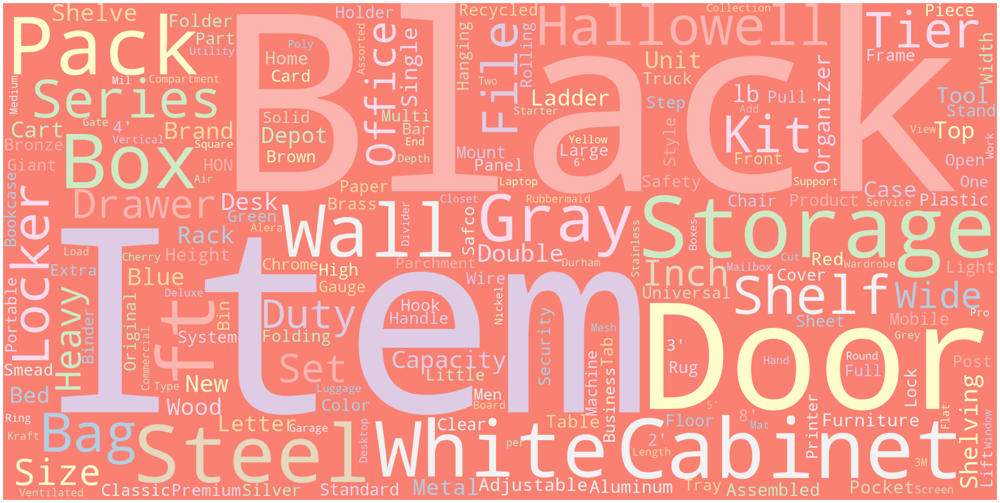

In [ ]:
from wordcloud import WordCloud, STOPWORDS
wordcloud = WordCloud(width = 2000, height = 1000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(text)
plot_cloud(wordcloud)

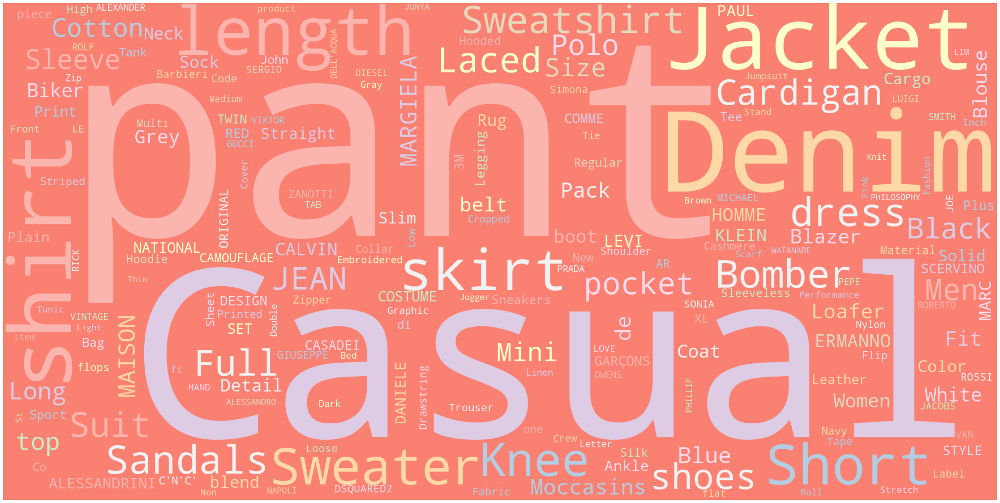

In [ ]:
temp = ' '.join(data[data.Clusters == 1]['Title'])
text = re.sub(r'==.*?==+', '', temp)
text = text.replace('\n', '')

wordcloud = WordCloud(width = 2000, height = 1000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(text)
plot_cloud(wordcloud)

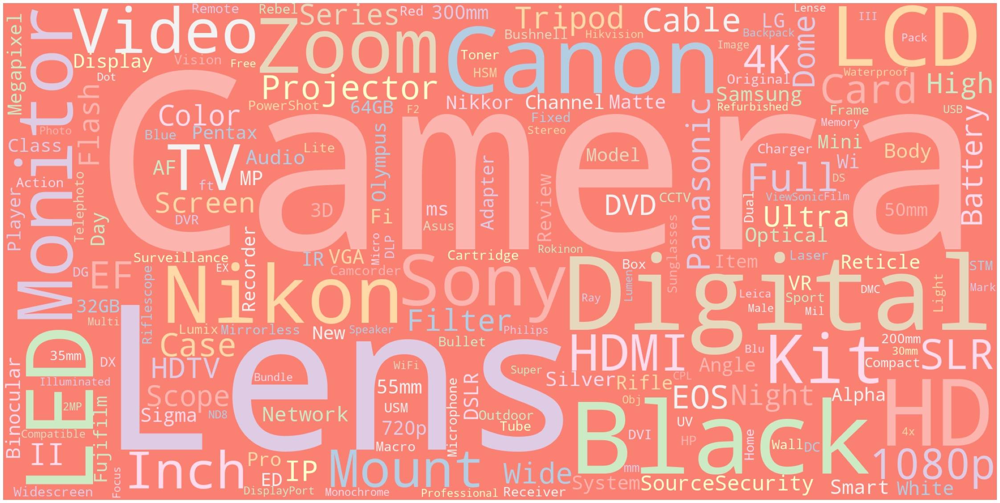

In [ ]:
temp = ' '.join(data[data.Clusters == 2]['Title'])
text = re.sub(r'==.*?==+', '', temp)
text = text.replace('\n', '')

wordcloud = WordCloud(width = 2000, height = 1000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(text)
plot_cloud(wordcloud)

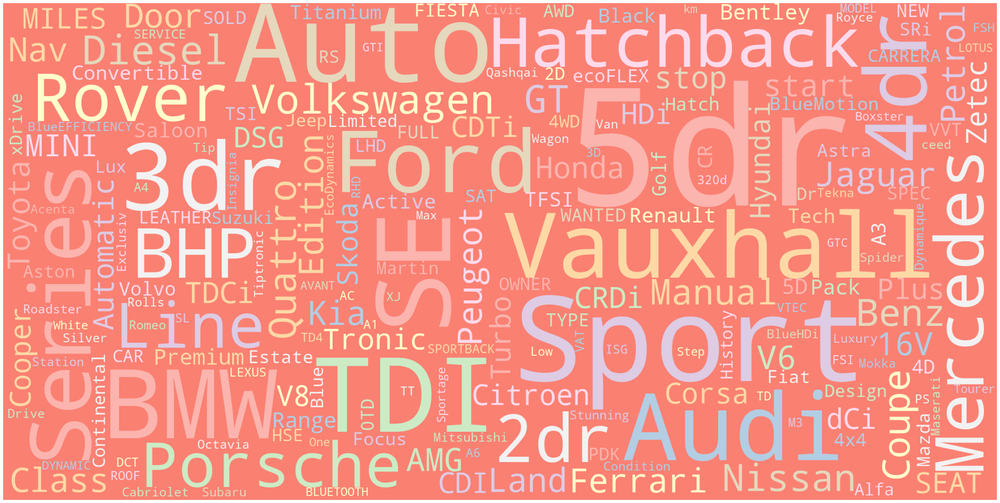

In [ ]:
temp = ' '.join(data[data.Clusters == 3]['Title'])
text = re.sub(r'==.*?==+', '', temp)
text = text.replace('\n', '')

wordcloud = WordCloud(width = 2000, height = 1000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(text)
plot_cloud(wordcloud)

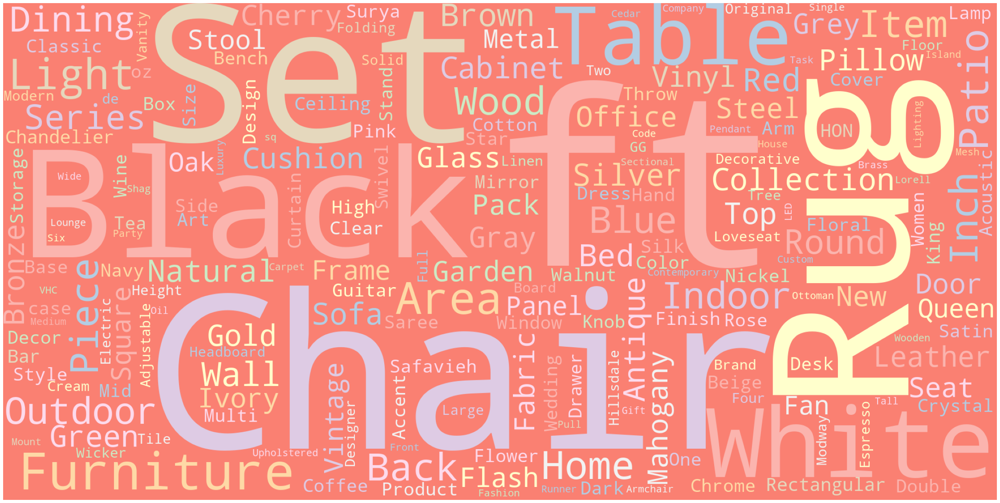

In [ ]:
temp = ' '.join(data[data.Clusters == 4]['Title'])
text = re.sub(r'==.*?==+', '', temp)
text = text.replace('\n', '')

wordcloud = WordCloud(width = 2000, height = 1000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(text)
plot_cloud(wordcloud)

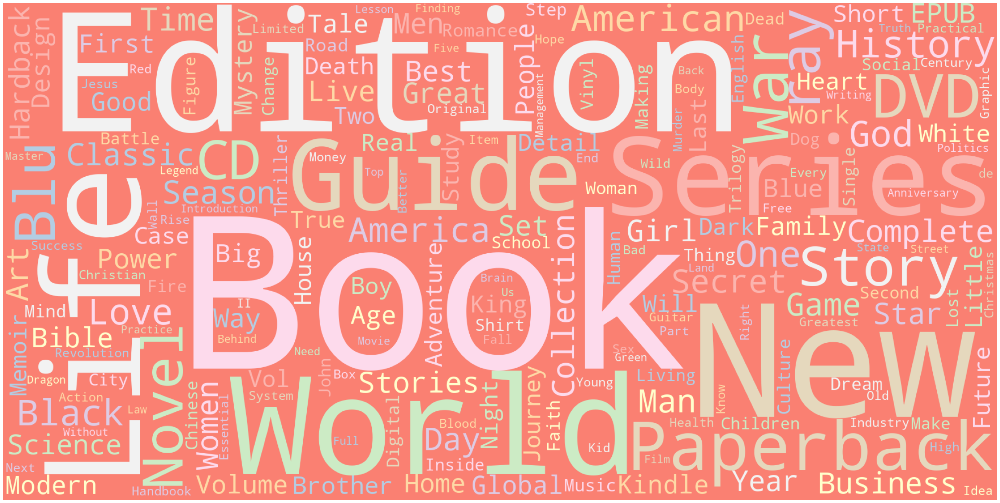

In [ ]:
temp = ' '.join(data[data.Clusters == 5]['Title'])
text = re.sub(r'==.*?==+', '', temp)
text = text.replace('\n', '')

wordcloud = WordCloud(width = 2000, height = 1000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(text)
plot_cloud(wordcloud)

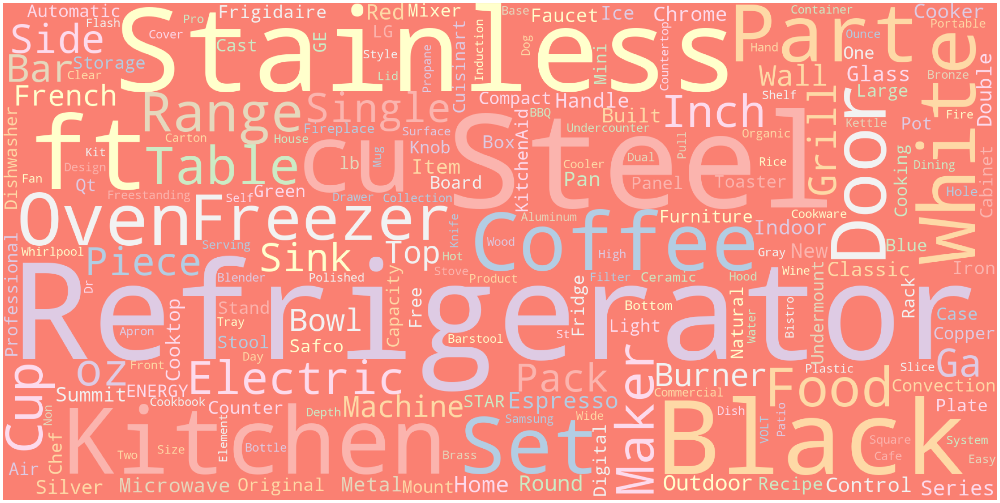

In [ ]:
temp = ' '.join(data[data.Clusters == 6]['Title'])
text = re.sub(r'==.*?==+', '', temp)
text = text.replace('\n', '')

wordcloud = WordCloud(width = 2000, height = 1000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(text)
plot_cloud(wordcloud)

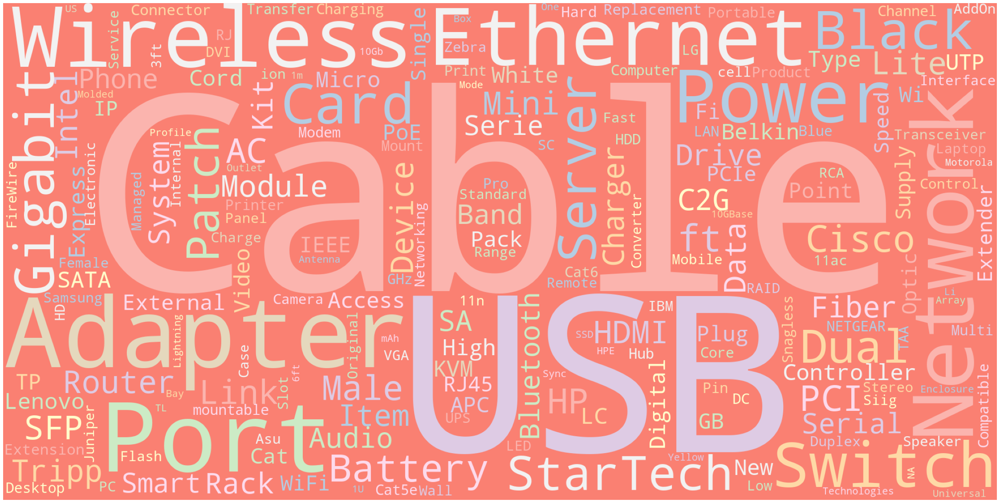

In [ ]:
temp = ' '.join(data[data.Clusters == 7]['Title'])
text = re.sub(r'==.*?==+', '', temp)
text = text.replace('\n', '')

wordcloud = WordCloud(width = 2000, height = 1000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(text)
plot_cloud(wordcloud)

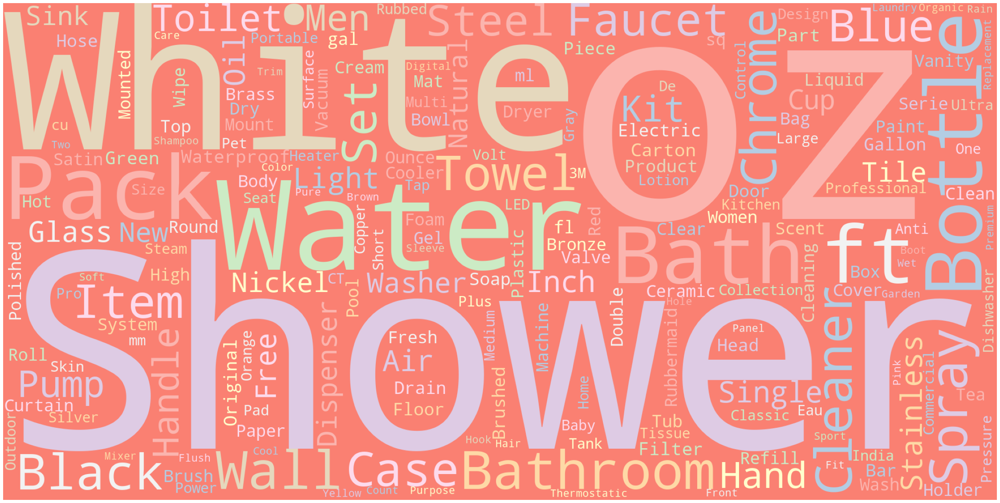

In [ ]:
temp = ' '.join(data[data.Clusters == 8]['Title'])
text = re.sub(r'==.*?==+', '', temp)
text = text.replace('\n', '')

wordcloud = WordCloud(width = 2000, height = 1000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(text)
plot_cloud(wordcloud)

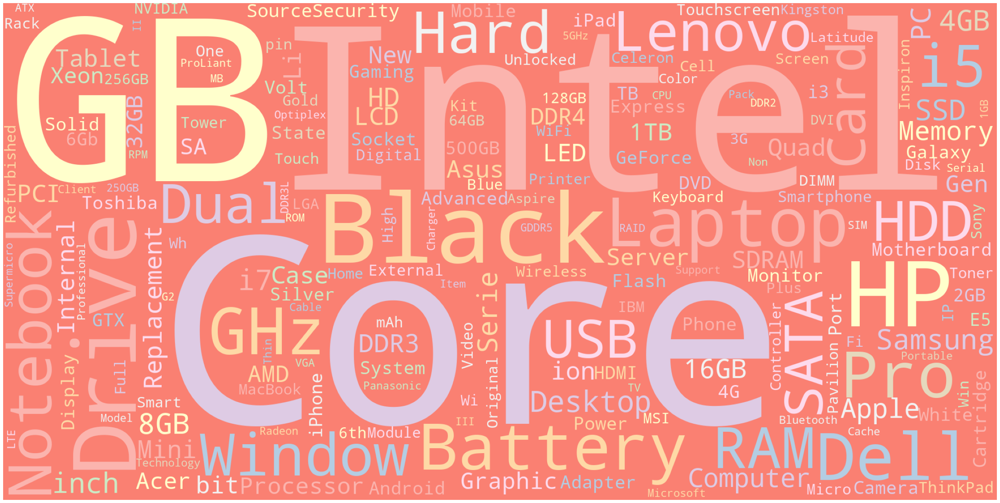

In [ ]:
temp = ' '.join(data[data.Clusters == 9]['Title'])
text = re.sub(r'==.*?==+', '', temp)
text = text.replace('\n', '')

wordcloud = WordCloud(width = 2000, height = 1000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(text)
plot_cloud(wordcloud)

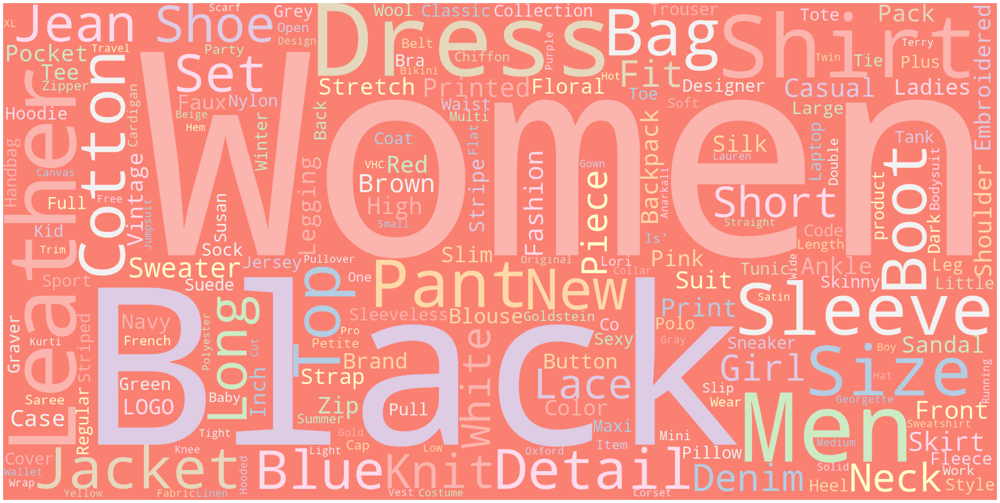

In [ ]:
temp = ' '.join(data[data.Clusters == 10]['Title'])
text = re.sub(r'==.*?==+', '', temp)
text = text.replace('\n', '')

wordcloud = WordCloud(width = 2000, height = 1000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(text)
plot_cloud(wordcloud)

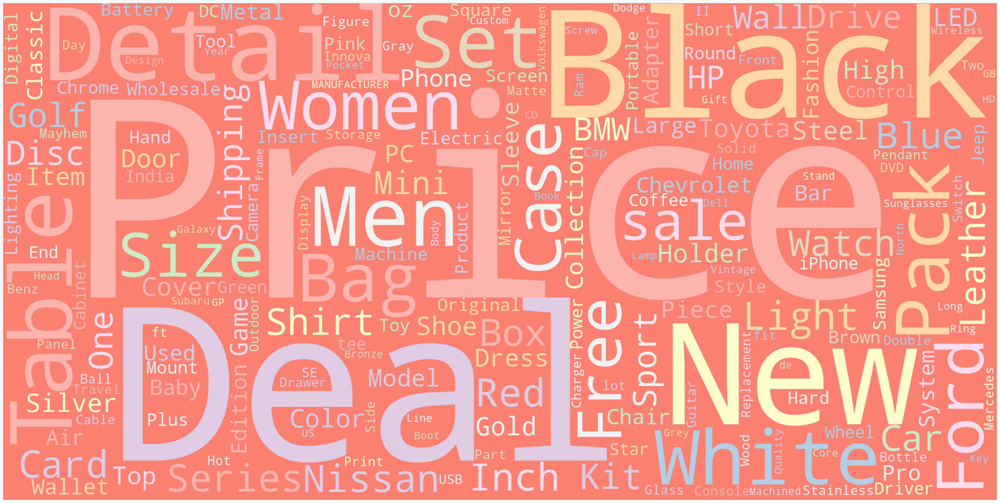

In [ ]:
temp = ' '.join(data[data.Clusters == 11]['Title'])
text = re.sub(r'==.*?==+', '', temp)
text = text.replace('\n', '')

wordcloud = WordCloud(width = 2000, height = 1000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(text)
plot_cloud(wordcloud)

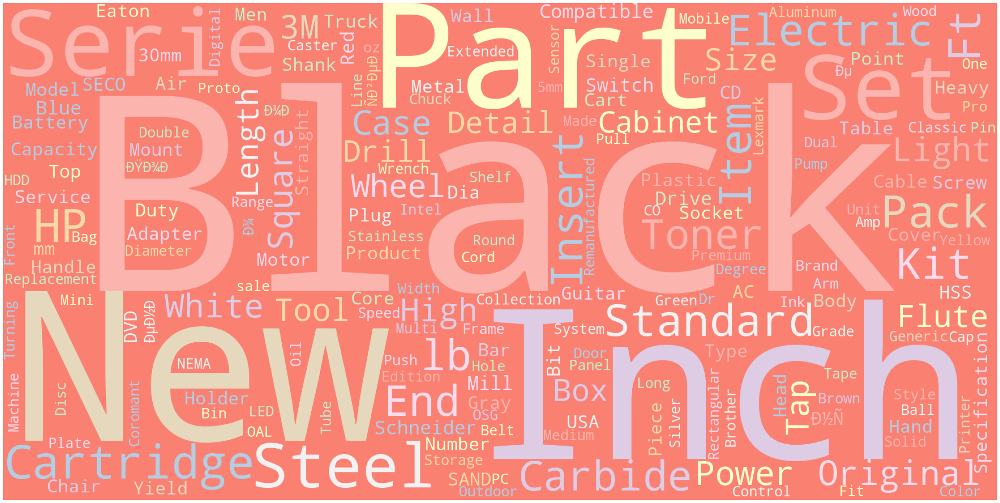

In [ ]:
temp = ' '.join(data[data.Clusters == 12]['Title'])
text = re.sub(r'==.*?==+', '', temp)
text = text.replace('\n', '')

wordcloud = WordCloud(width = 2000, height = 1000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(text)
plot_cloud(wordcloud)

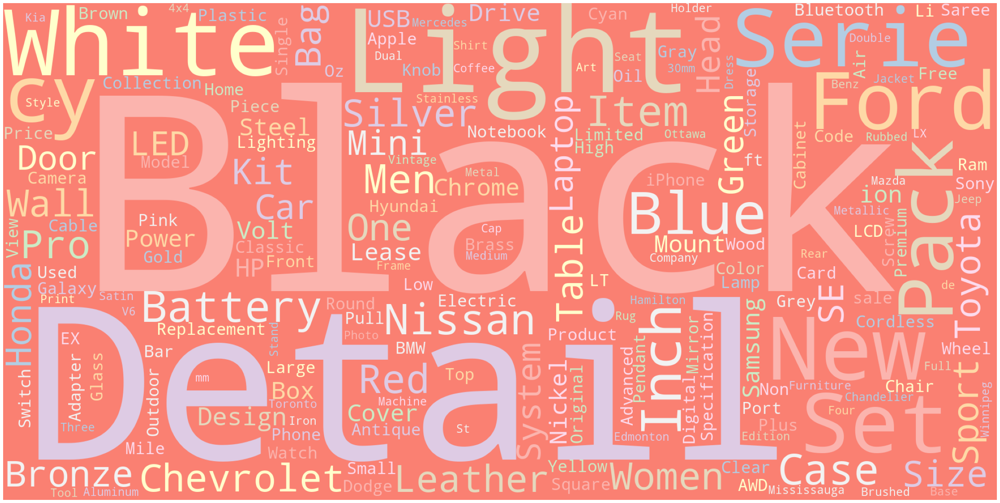

In [ ]:
temp = ' '.join(data[data.Clusters == 13]['Title'])
text = re.sub(r'==.*?==+', '', temp)
text = text.replace('\n', '')

wordcloud = WordCloud(width = 2000, height = 1000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(text)
plot_cloud(wordcloud)

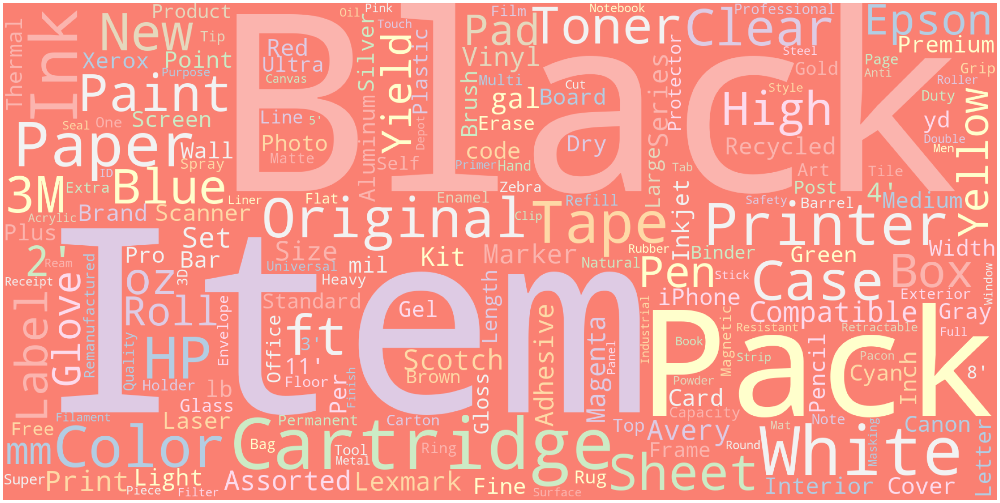

In [ ]:
temp = ' '.join(data[data.Clusters == 14]['Title'])
text = re.sub(r'==.*?==+', '', temp)
text = text.replace('\n', '')

wordcloud = WordCloud(width = 2000, height = 1000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(text)
plot_cloud(wordcloud)

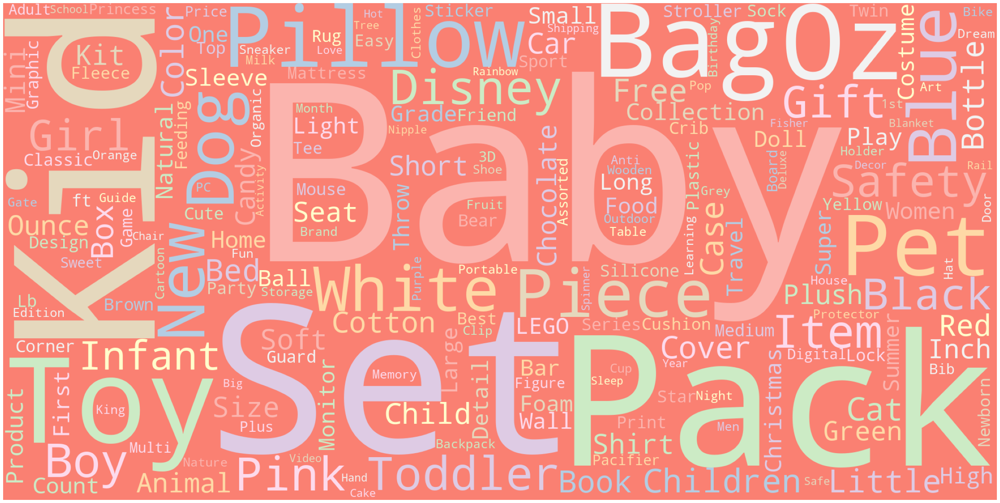

In [ ]:
temp = ' '.join(data[data.Clusters == 15]['Title'])
text = re.sub(r'==.*?==+', '', temp)
text = text.replace('\n', '')

wordcloud = WordCloud(width = 2000, height = 1000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(text)
plot_cloud(wordcloud)

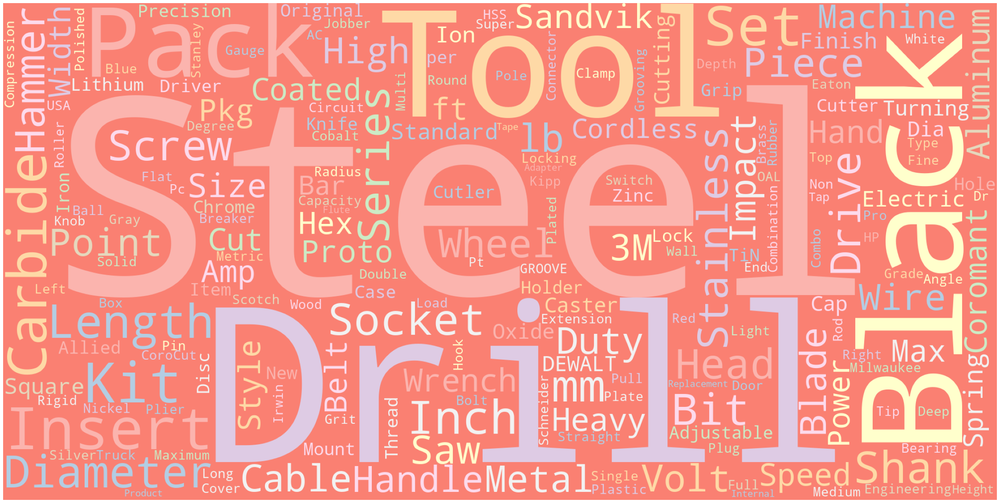

In [ ]:
temp = ' '.join(data[data.Clusters == 16]['Title'])
text = re.sub(r'==.*?==+', '', temp)
text = text.replace('\n', '')

wordcloud = WordCloud(width = 2000, height = 1000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(text)
plot_cloud(wordcloud)

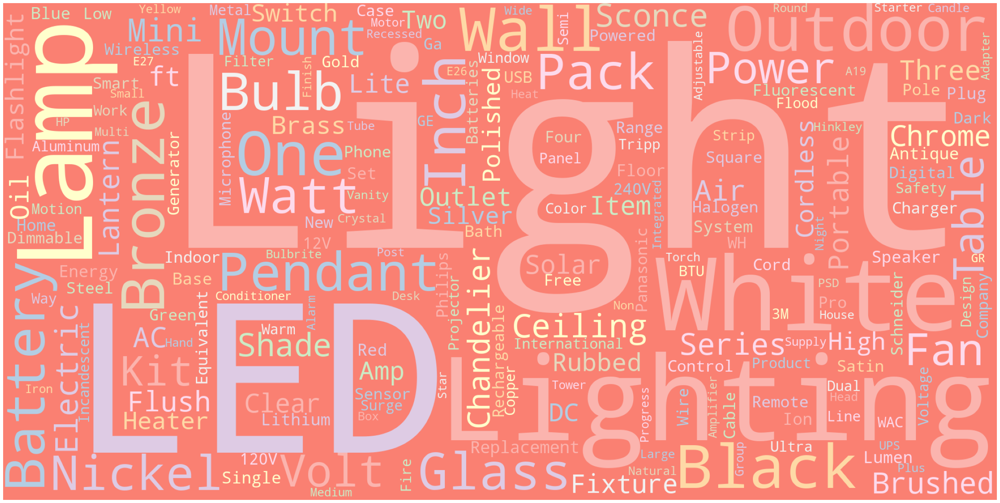

In [ ]:
temp = ' '.join(data[data.Clusters == 17]['Title'])
text = re.sub(r'==.*?==+', '', temp)
text = text.replace('\n', '')

wordcloud = WordCloud(width = 2000, height = 1000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(text)
plot_cloud(wordcloud)

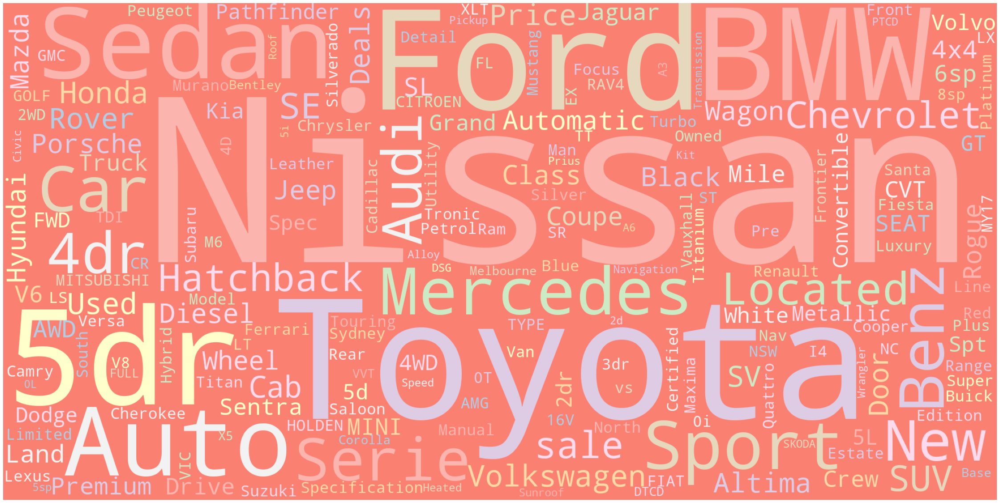

In [ ]:
temp = ' '.join(data[data.Clusters == 18]['Title'])
text = re.sub(r'==.*?==+', '', temp)
text = text.replace('\n', '')

wordcloud = WordCloud(width = 2000, height = 1000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(text)
plot_cloud(wordcloud)

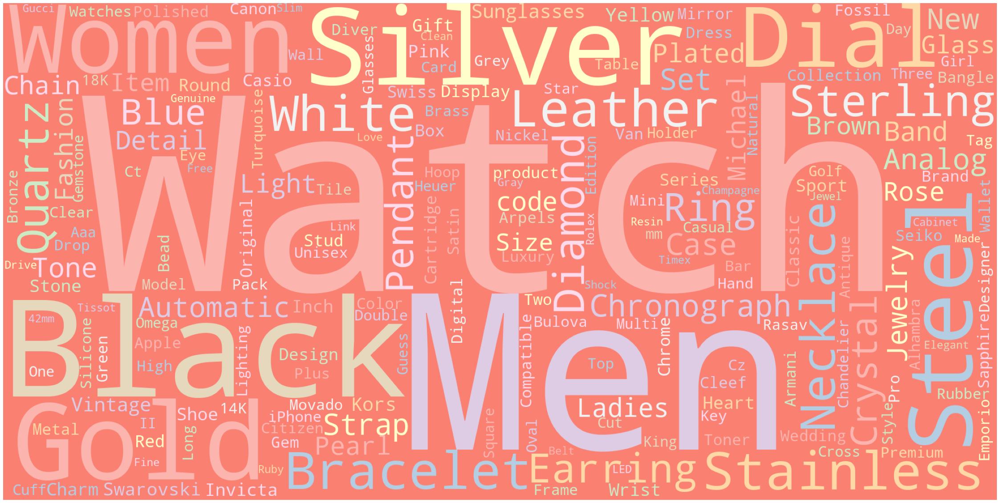

In [ ]:
temp = ' '.join(data[data.Clusters == 19]['Title'])
text = re.sub(r'==.*?==+', '', temp)
text = text.replace('\n', '')

wordcloud = WordCloud(width = 2000, height = 1000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(text)
plot_cloud(wordcloud)

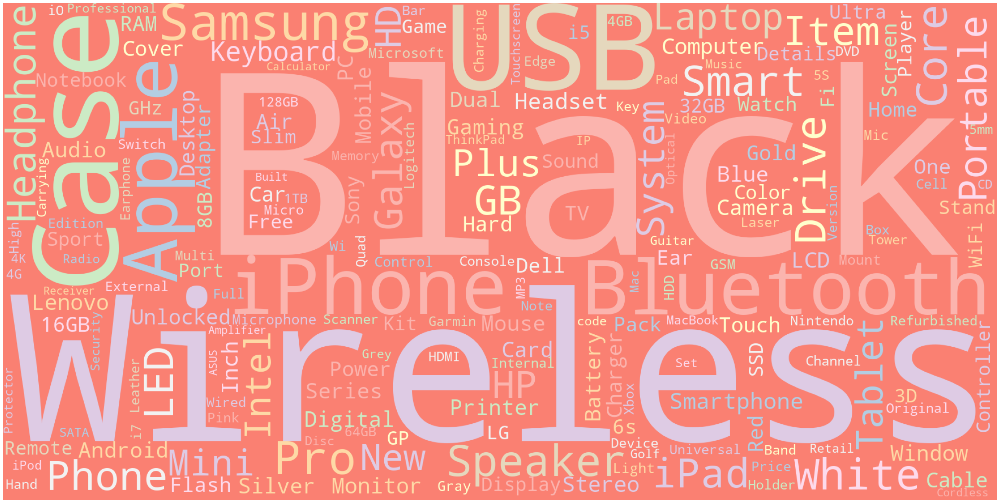

In [ ]:
temp = ' '.join(data[data.Clusters == 20]['Title'])
text = re.sub(r'==.*?==+', '', temp)
text = text.replace('\n', '')

wordcloud = WordCloud(width = 2000, height = 1000, random_state=1, background_color='salmon', colormap='Pastel1', collocations=False, stopwords = STOPWORDS).generate(text)
plot_cloud(wordcloud)